In [ ]:
import os
import pickle
import numpy as np
import torch
import PIL.Image
from pathlib import Path
import time

In [ ]:
!git clone https://github.com/NVlabs/stylegan2-ada-pytorch.git
%cd stylegan2-ada-pytorch

Cloning into 'stylegan2-ada-pytorch'...
remote: Enumerating objects: 131, done.
remote: Counting objects: 100% (2/2), done.
remote: Compressing objects: 100% (2/2), done.
remote: Total 131 (delta 0), reused 0 (delta 0), pack-reused 129 (from 2)
Receiving objects: 100% (131/131), 1.13 MiB | 2.65 MiB/s, done.
Resolving deltas: 100% (57/57), done.
/content/stylegan2-ada-pytorch


In [ ]:
!pip install torch==1.13.1 torchvision==0.14.1 --extra-index-url https://download.pytorch.org/whl/cu118
!pip install click requests tqdm pyspng ninja imageio-ffmpeg==0.4.3

model_file = 'ffhq.pkl'
if not Path(model_file).exists():
    !wget https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl

Looking in indexes: https://pypi.org/simple, https://download.pytorch.org/whl/cu118
ERROR: Ignored the following yanked versions: 0.1.6, 0.1.7, 0.1.8, 0.1.9, 0.2.0, 0.2.1, 0.2.2, 0.2.2.post2, 0.2.2.post3, 0.15.0
ERROR: Could not find a version that satisfies the requirement torchvision==0.14.1 (from versions: 0.1.6, 0.2.0, 0.15.0+cu118, 0.15.1, 0.15.1+cu118, 0.15.2, 0.15.2+cu118, 0.16.0, 0.16.0+cu118, 0.16.1, 0.16.1+cu118, 0.16.2, 0.16.2+cu118, 0.17.0, 0.17.0+cu118, 0.17.1, 0.17.1+cu118, 0.17.2, 0.17.2+cu118, 0.18.0, 0.18.0+cu118, 0.18.1, 0.18.1+cu118, 0.19.0, 0.19.0+cu118, 0.19.1, 0.19.1+cu118, 0.20.0, 0.20.0+cu118, 0.20.1, 0.20.1+cu118, 0.21.0, 0.21.0+cu118, 0.22.0, 0.22.0+cu118, 0.22.1, 0.22.1+cu118)
ERROR: No matching distribution found for torchvision==0.14.1
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 55.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.1/196.1 kB 19.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.8/422.8 kB 42.1 M

In [ ]:
output_dir = f"random_faces_{int(time.time())}"
os.makedirs(output_dir, exist_ok=True)

Loading StyleGAN2 model...
Generating 10 random faces...


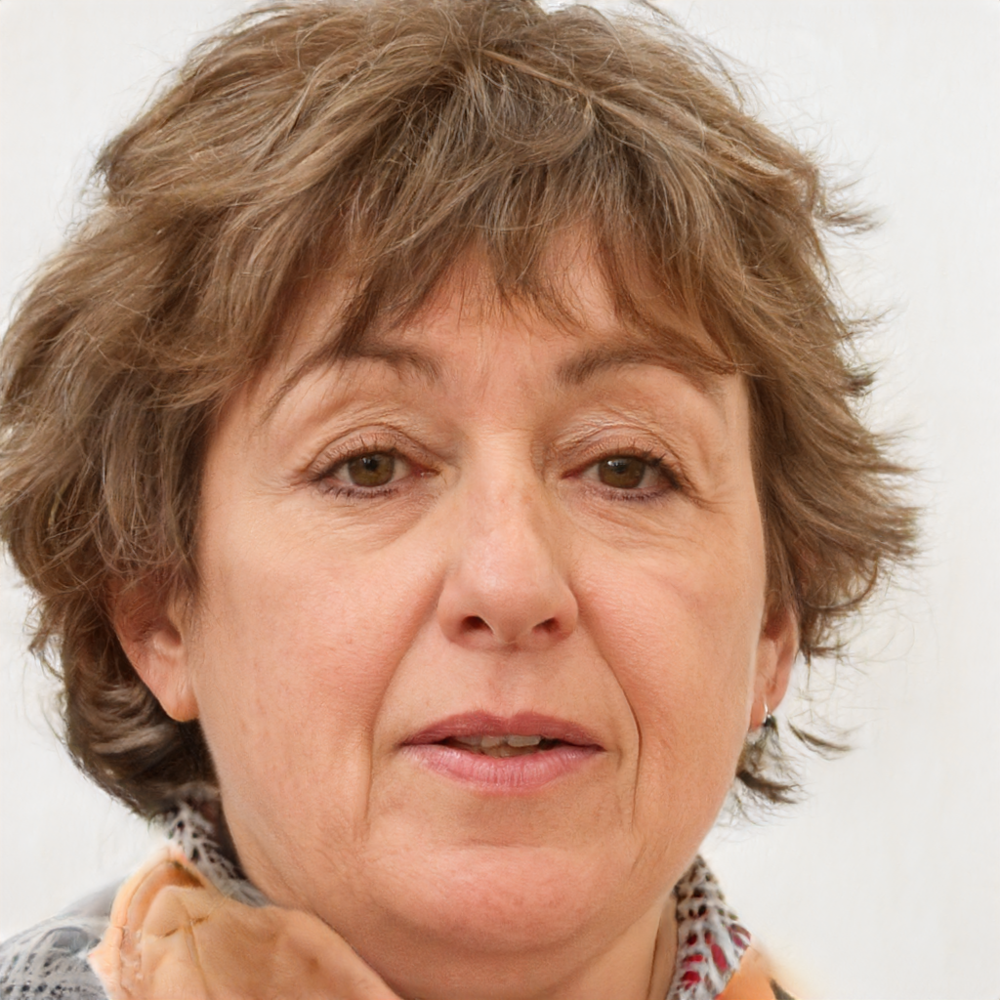

Generated face 1/10


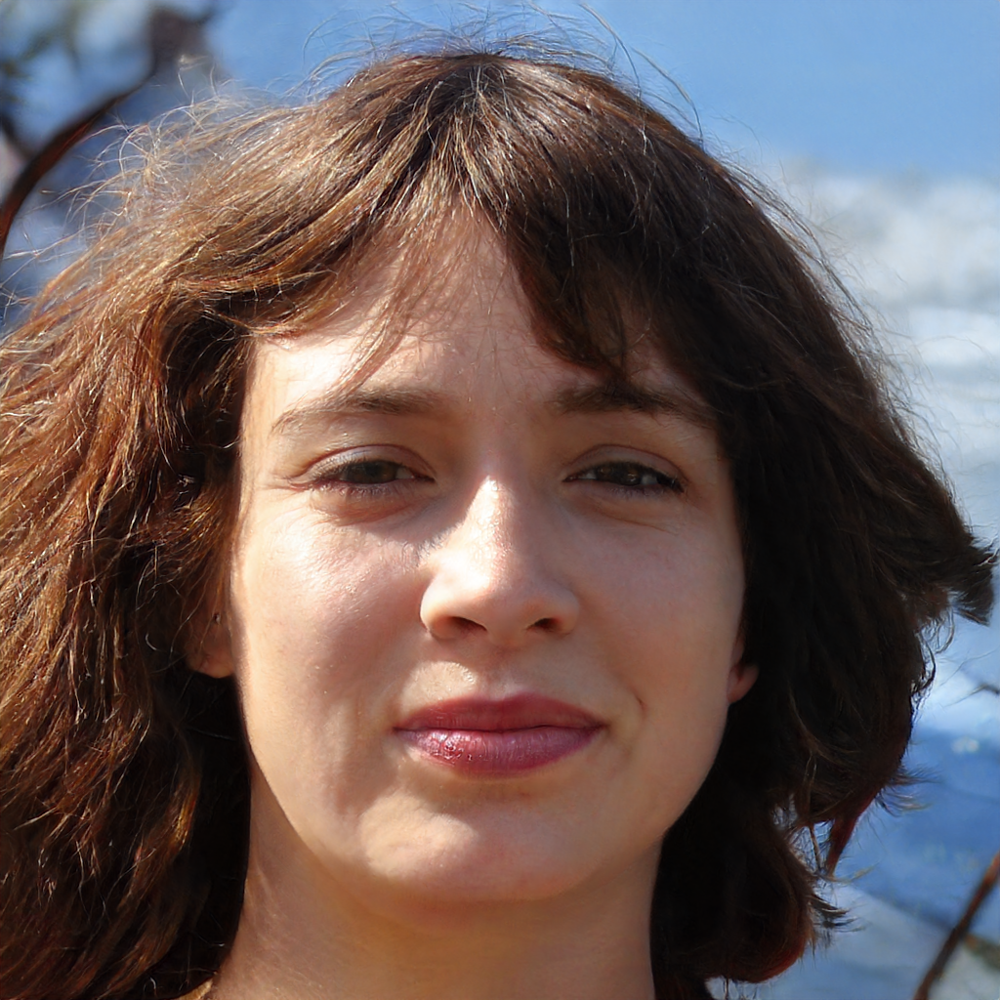

Generated face 2/10


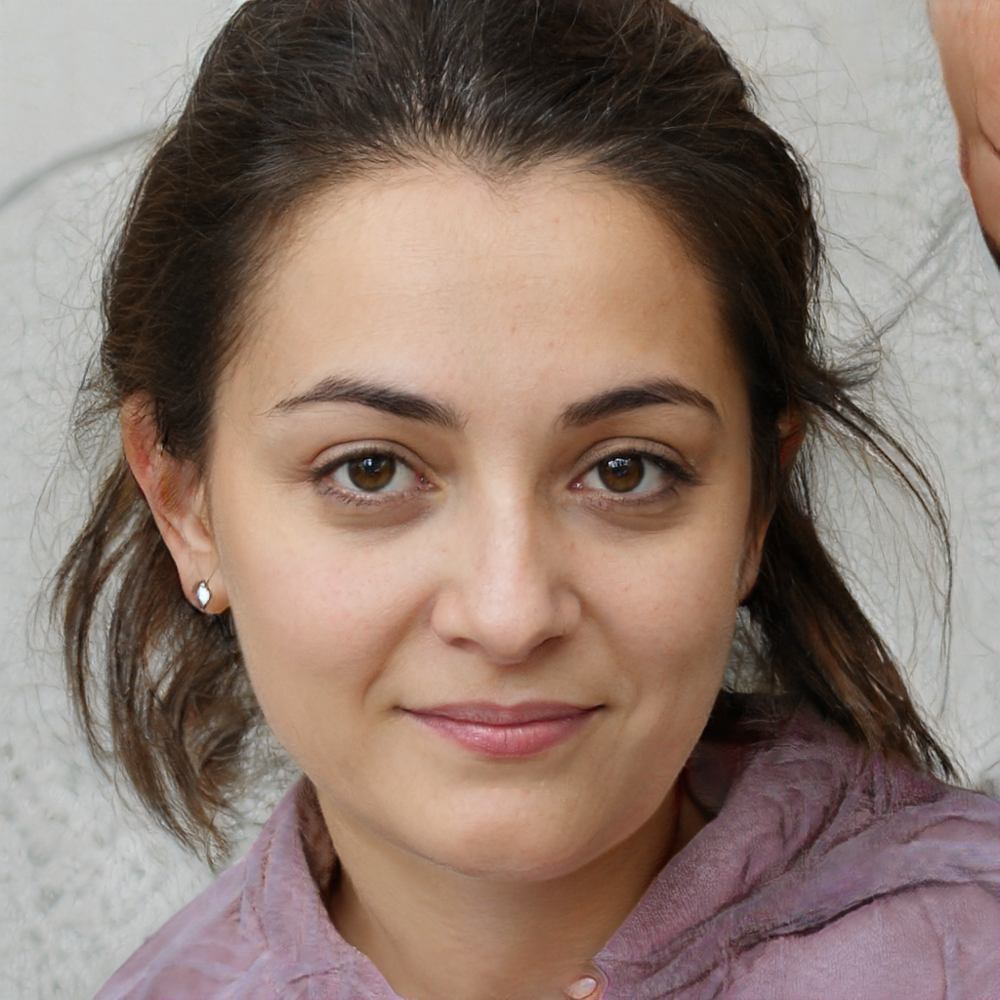

Generated face 3/10


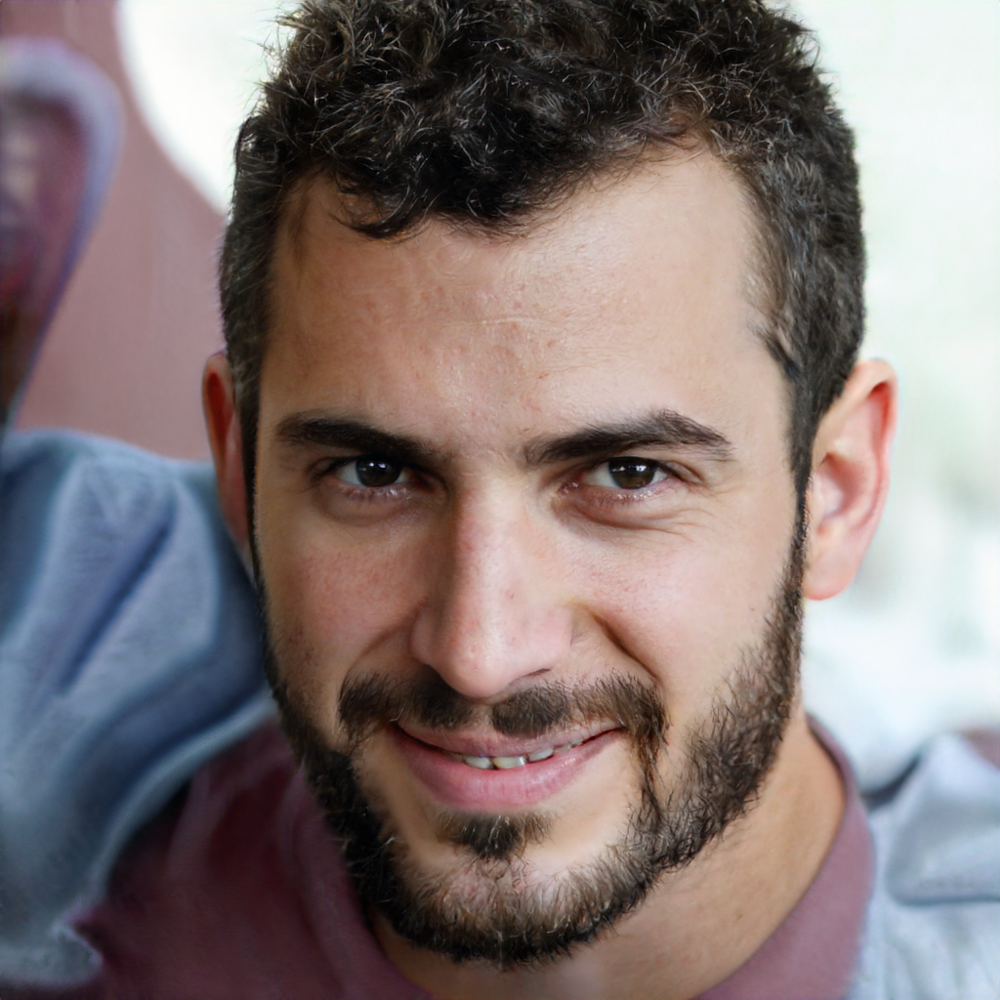

Generated face 4/10


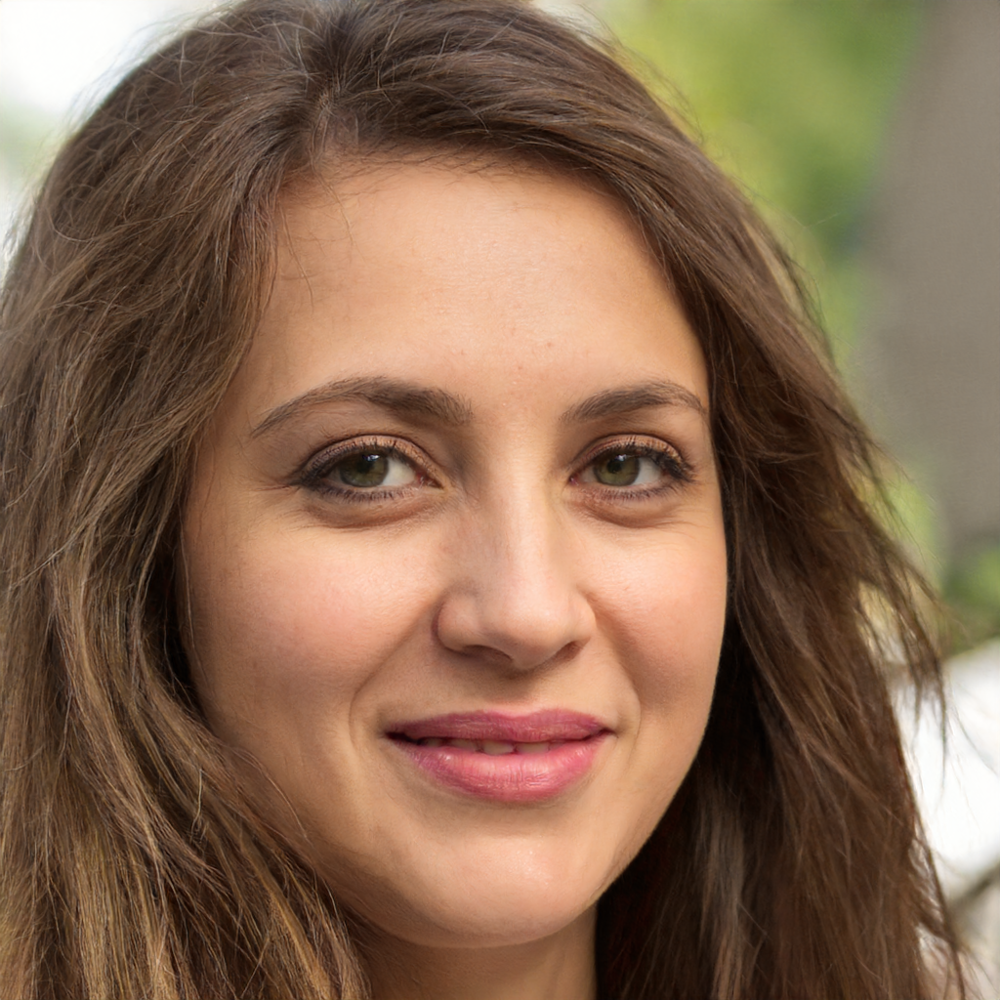

Generated face 5/10


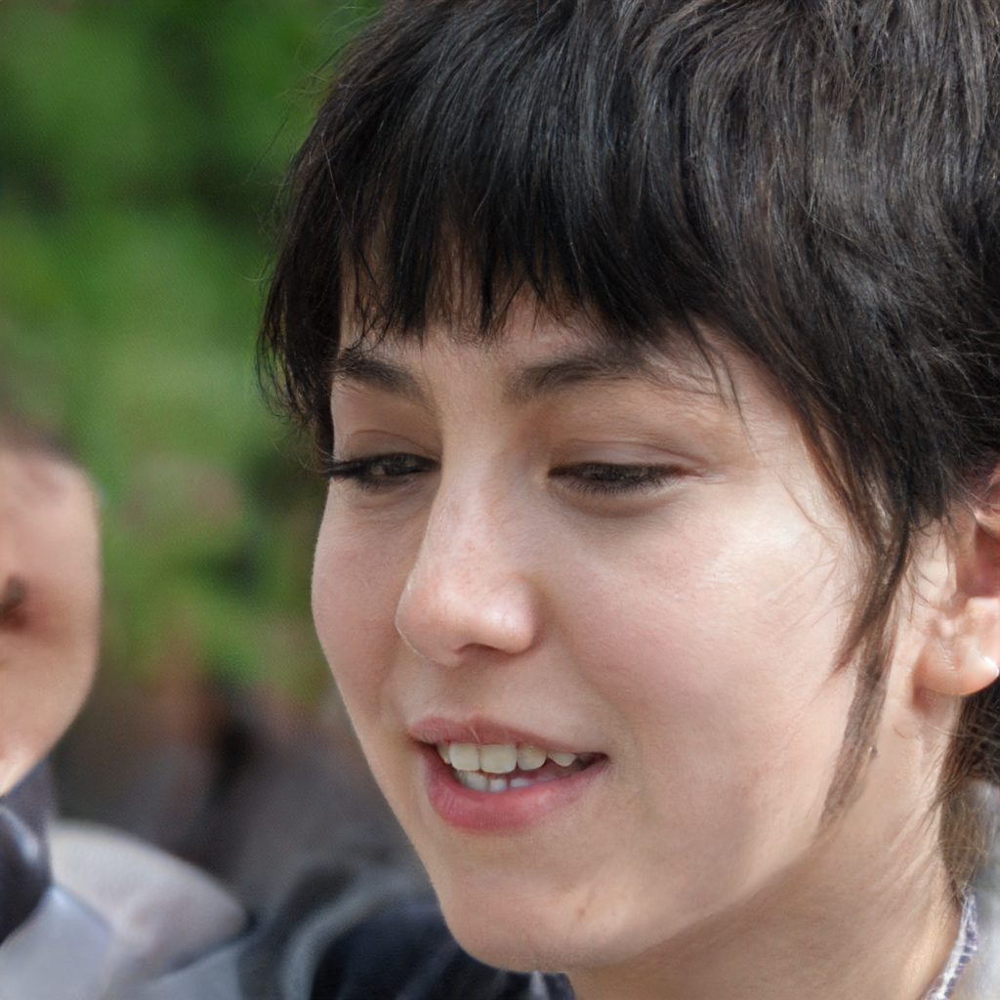

Generated face 6/10


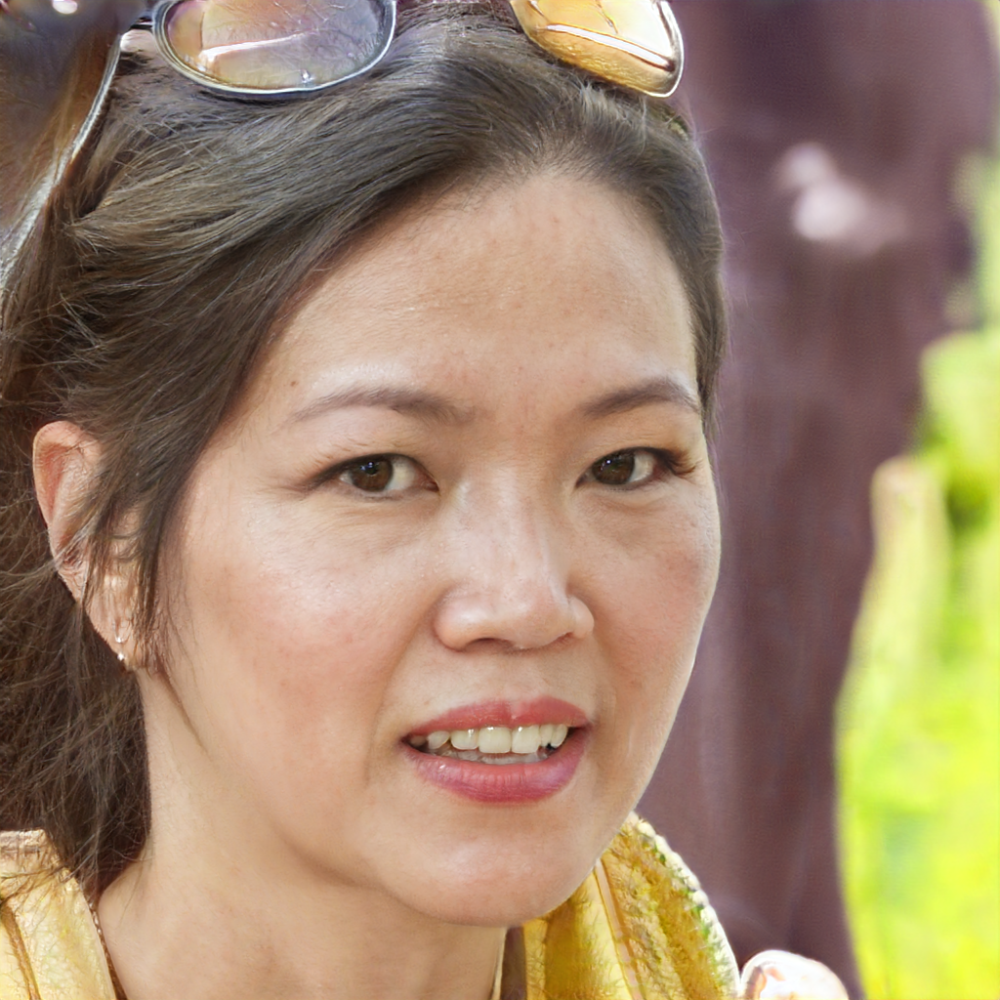

Generated face 7/10


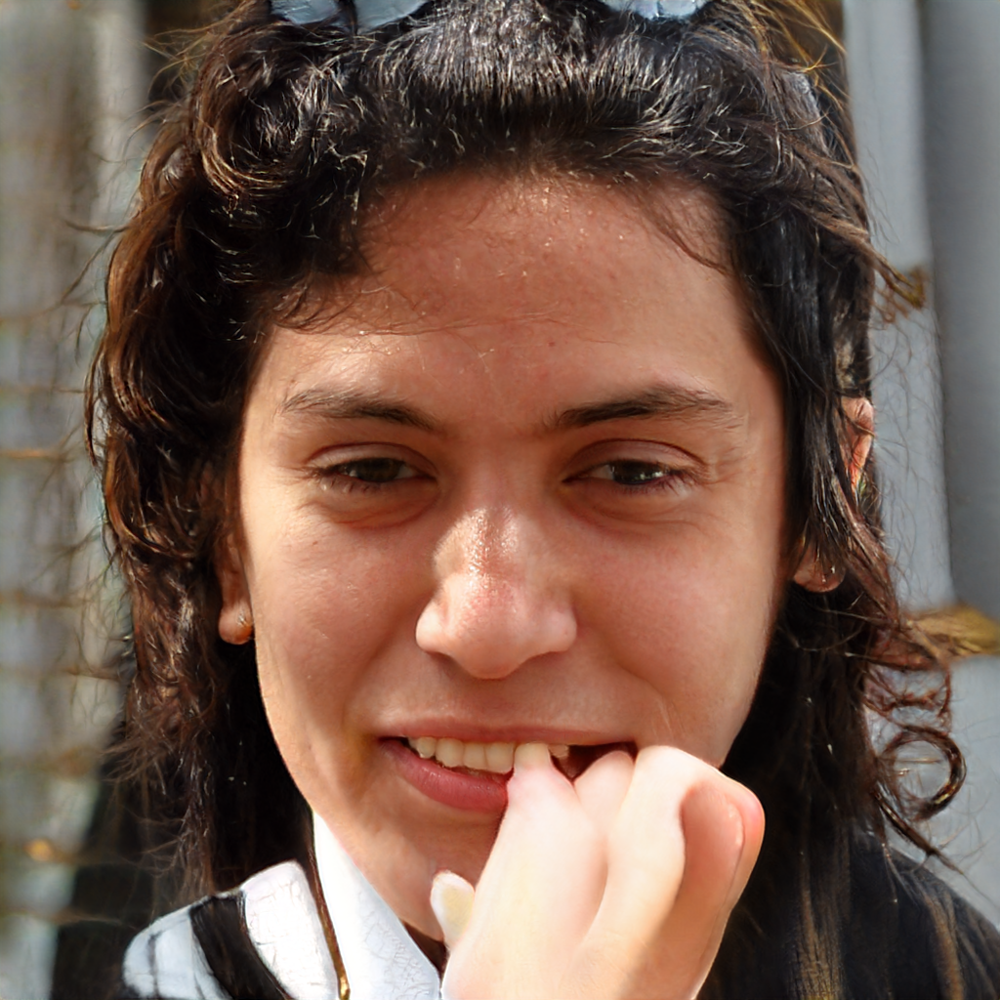

Generated face 8/10


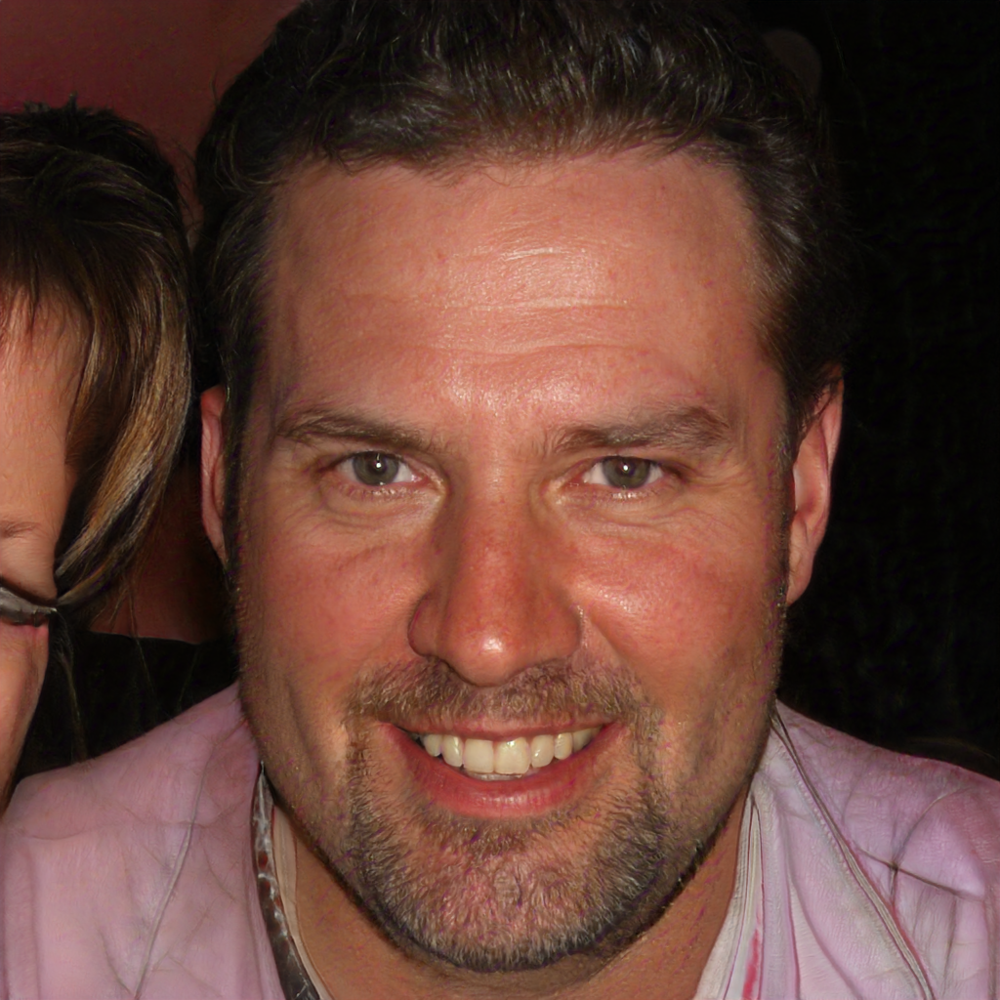

Generated face 9/10


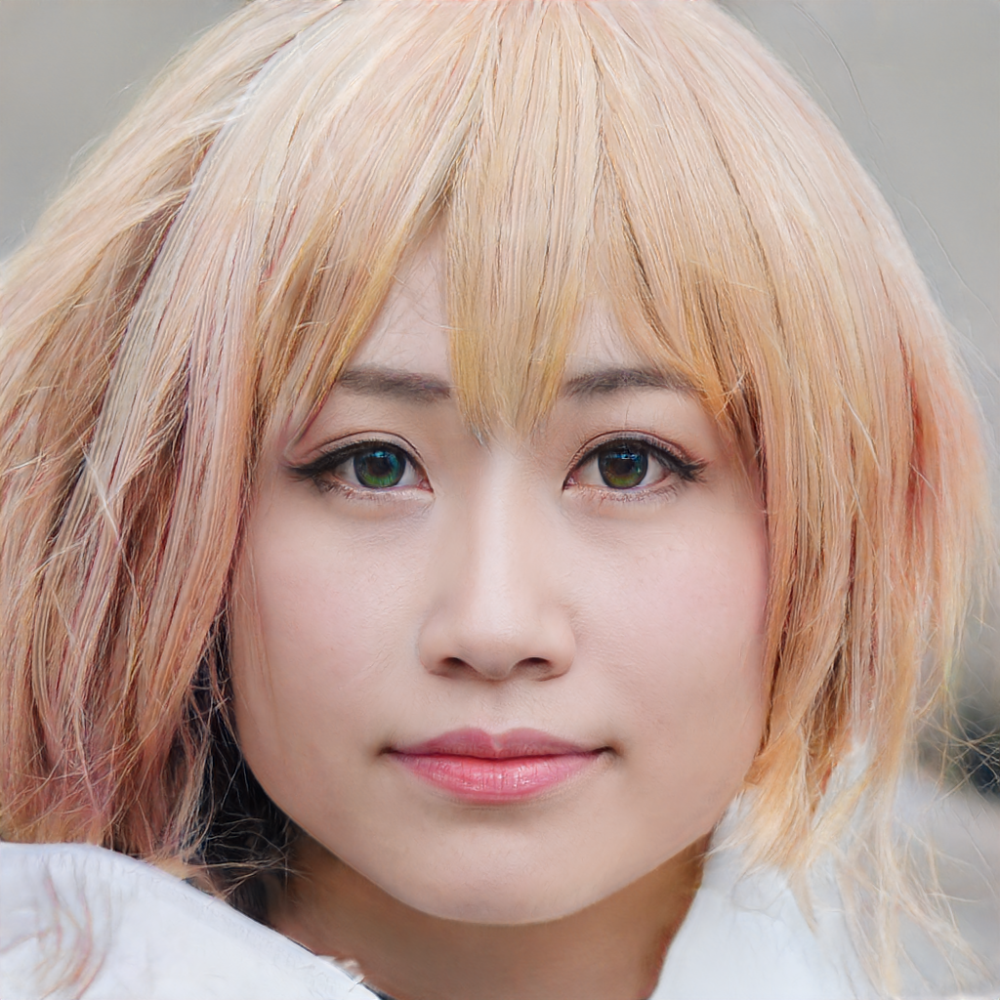

Generated face 10/10
All faces and latent vectors have been saved to 'random_faces_1751211471'
Z-space vectors are stored as 'z_latent_*.npy'
W-space vectors are stored as 'w_latent_*.npy'
Images are stored as 'face_*.png'


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Downloaded random_faces_1751211471.zip


In [ ]:
print("Loading StyleGAN2 model...")
with open('ffhq.pkl', 'rb') as f:
    model = pickle.load(f)
    G = model['G_ema'].cuda()

num_faces = 10
truncation_psi = 0.7

print(f"Generating {num_faces} random faces...")

for i in range(num_faces):
    z = np.random.randn(1, 512)
    z_torch = torch.from_numpy(z).to('cuda').float()

    w = G.mapping(z_torch, None, truncation_psi=truncation_psi)

    img = G.synthesis(w, noise_mode='const')

    img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
    pil_img = PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB')

    z_file = f"{output_dir}/z_latent_{i}.npy"
    w_file = f"{output_dir}/w_latent_{i}.npy"
    img_file = f"{output_dir}/face_{i}.png"

    np.save(z_file, z)
    np.save(w_file, w.cpu().detach().numpy())
    pil_img.save(img_file)

    display(pil_img)
    print(f"Generated face {i+1}/{num_faces}")

print(f"All faces and latent vectors have been saved to '{output_dir}'")
print("Z-space vectors are stored as 'z_latent_*.npy'")
print("W-space vectors are stored as 'w_latent_*.npy'")
print("Images are stored as 'face_*.png'")

try:
    from google.colab import files
    import shutil

    zip_filename = f"{output_dir}.zip"
    shutil.make_archive(output_dir, 'zip', output_dir)
    files.download(zip_filename)
    print(f"Downloaded {zip_filename}")
except ImportError:
    pass  # Not running in Colab